# Урок 5
В этой демонстрации попрактикуемся в решении некоторых задач CV.

1. Задача семантической сегментации: построим сеть, обучим ее, замерим качество.
2. Генерация изображений: воспользуемся предобученной сетью GAN для генерации лиц и посмотрим на качество.

## Семантическая сегментация в PyTorch

Напомним постановку.
В задаче семантической сегментации мы хотим каждому пикселю изображения поставить в соответствие одну метку класса.

В качестве датасета возьмем NYUv2.

В качестве модели возьмем U-Net. Оптимизировать будем кросс-энтропию, усредненную по всем пикселям.

В качестве метрики качества возьмем IoU.

<KeysViewHDF5 ['#refs#', '#subsystem#', 'accelData', 'depths', 'images', 'instances', 'labels', 'names', 'namesToIds', 'rawDepthFilenames', 'rawDepths', 'rawRgbFilenames', 'sceneTypes', 'scenes']>

<HDF5 dataset "labels": shape (1449, 640, 480), type "<u2">

<HDF5 dataset "images": shape (1449, 3, 640, 480), type "|u1">


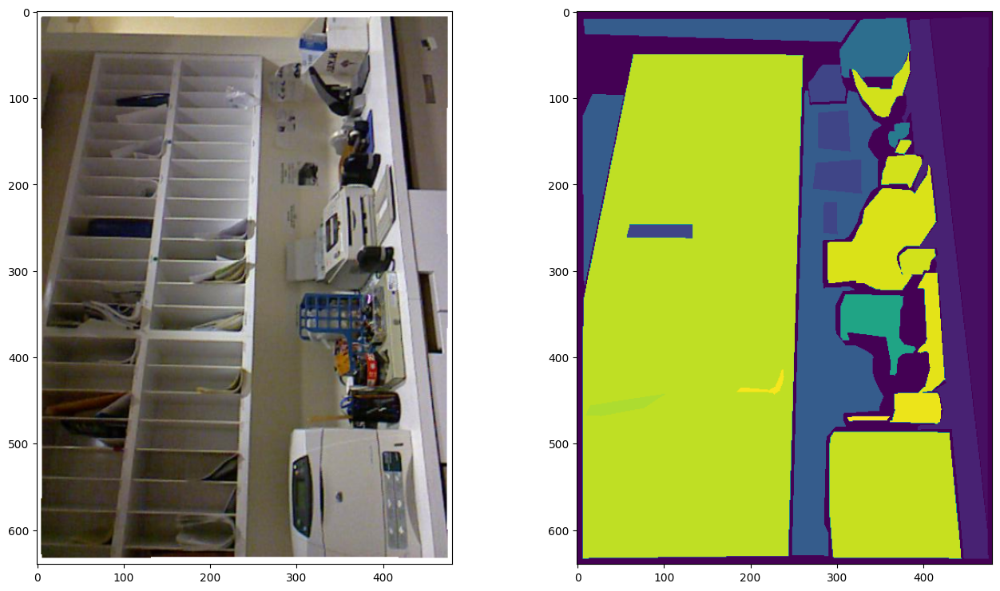

In [ ]:
# Скачайте "labeled dataset" отсюда https://cs.nyu.edu/~fergus/datasets/nyu_depth_v2.html
# Прямая ссылка http://horatio.cs.nyu.edu/mit/silberman/nyu_depth_v2/nyu_depth_v2_labeled.mat

# Датасет в немного необычном формате, код ниже приводит его в тензоры
import h5py
import torch
import numpy as np
import matplotlib.pyplot as plt


def show_sample(img_np: np.ndarray, label_np: np.ndarray):
    _, ax = plt.subplots(1, 2, figsize=(16, 9))
    ax[0].imshow(img_np.transpose((1, 2, 0)))
    ax[1].imshow(label_np)
    plt.show()


# Считаем из HDF5 формата
# Подробнее про h5py: https://docs.h5py.org/en/stable/quick.html#quick
data = h5py.File("nyu_depth_v2_labeled.mat")
print(data.keys())
print()
print(data["labels"])
print()
print(data["images"])

# Преобразуем в numpy-массив
raw_images, raw_labels = data["images"], data["labels"]
del data
all_imgs_np, all_labels_np = np.empty_like(raw_images), np.empty_like(raw_labels)
raw_images.read_direct(all_imgs_np)
raw_labels.read_direct(all_labels_np)
del raw_images, raw_labels

# Покажем пример одной картинки
show_sample(all_imgs_np[10], all_labels_np[10])

In [ ]:
# Какой размер датасета?
def print_size_mb(tensor: np.ndarray):
    print("Size in Mb:", tensor.itemsize * tensor.size >> 20)

print_size_mb(all_imgs_np)
print_size_mb(all_labels_np)

Size in Mb: 1273
Size in Mb: 849


Будем разбивать на батчи.

In [ ]:
seed = 0
batch_size = 4
n_steps_before_backward = 8
# С точки зрения оптимизации будет real_batch_size = batch_size * n_steps_before_backward

In [ ]:
import os
import random


def enable_determinism():
    os.environ["CUBLAS_WORKSPACE_CONFIG"] = ":4096:8"
    torch.use_deterministic_algorithms(True)


def fix_seeds(seed: int):
    np.random.seed(seed)
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.mps.manual_seed(seed)


enable_determinism()
fix_seeds(0)

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torch.utils.data import Dataset


class SegmentationDataset(Dataset):
    def __init__(
        self, img_array: np.ndarray, label_array: np.ndarray, transforms: A.Compose
    ):
        label_array = label_array.astype("int32")
        self.img_array = img_array.transpose((0, 2, 3, 1))
        self.label_array = label_array
        self.transforms = transforms

    def __getitem__(self, index):
        transformed = self.transforms(
            image=self.img_array[index], mask=self.label_array[index]
        )
        return transformed["image"], transformed["mask"]

    def __len__(self):
        return len(self.img_array)


all_dataset = SegmentationDataset(
    all_imgs_np,
    all_labels_np,
    transforms=A.Compose([A.Resize(128, 128), A.ToFloat(max_value=255), ToTensorV2()]),
)

torch.Size([3, 128, 128])


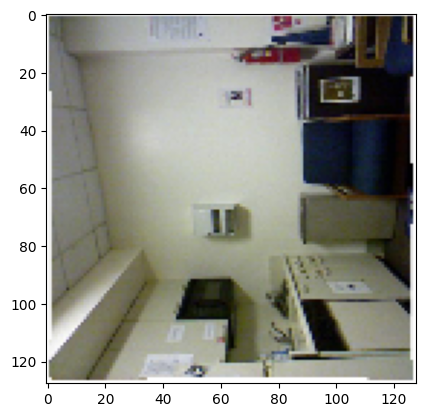

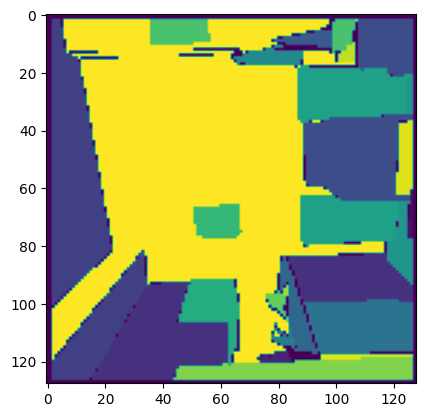

In [ ]:
print(all_dataset[0][0].shape)
plt.imshow(all_dataset[0][0].permute((1, 2, 0)))
plt.show()
plt.imshow(all_dataset[0][1])

In [ ]:
from torch.utils.data import DataLoader, random_split

generator = torch.Generator().manual_seed(seed)
train_dataset, val_dataset, test_dataset = random_split(
    all_dataset, [0.8, 0.1, 0.1], generator=generator
)
train_loader = DataLoader(
    train_dataset, batch_size=batch_size, shuffle=True, generator=generator
)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [ ]:
from functools import reduce

import torch.nn as nn
import torch.nn.functional as F
import tqdm
import wandb
from torch.optim import Adam


def calc_accuracy(model: nn.Module, loader: DataLoader, device: torch.device):
    count_correct, count_total = 0, 0
    model.eval()
    for img_batch, true_labels in loader:
        img_batch = img_batch.to(device)
        true_labels = true_labels.to(device)
        with torch.no_grad():
            prediction = model(img_batch)
        # (B, K, H, W)
        # pred_labels = (prediction > 0).squeeze(1)
        pred_labels = torch.argmax(prediction, dim=1)
        count_correct += (pred_labels == true_labels).sum().item()
        # произведение всех размерностей
        count_total += reduce(lambda a, b: a * b, true_labels.shape, 1)
    model.train()
    return count_correct / count_total


def train_loop(
    model: nn.Module,
    train_loader: DataLoader,
    val_loader: DataLoader,
    device: torch.device,
):
    lr = 1e-3
    n_epochs = 10
    eval_every = 20
    optimizer = Adam(model.parameters(), lr=lr)
    model.to(device)
    criterion = nn.CrossEntropyLoss(reduction="none")

    for epoch in range(n_epochs):
        print(f"Epoch #{epoch + 1}/#{n_epochs}")
        for i, (img_batch, true_labels) in enumerate(tqdm.tqdm(train_loader)):
            step = epoch * len(train_loader) + i
            img_batch, true_labels = img_batch.to(device), true_labels.to(device)

            pred_labels = model(img_batch).squeeze()
            loss = criterion(pred_labels, true_labels.long()).mean()
            loss.backward()

            # Будем не каждую итерацию делать шаг спуска.
            # Это увеличит batch_size без необходимости вмещать больше в память.
            if (step + 1) % n_steps_before_backward == 0:
                optimizer.step()
                optimizer.zero_grad()


            wandb.log({"loss": loss.cpu().item()}, step=step)
            if (i + 1) % eval_every == 0:
                wandb.log(
                    {"accuracy": calc_accuracy(model, val_loader, device)}, step=step
                )
        wandb.log({"accuracy": calc_accuracy(model, val_loader, device)}, step=step)

In [ ]:
# Всего 895 классов
n_classes = 895

Будем использовать `ConvTranspose2d`. Как это работает:

![input](https://i.stack.imgur.com/wnE5e.png)

Ядро накладывается на каждый пиксель, потом результаты суммируются.
Как бы "свертка наоборот".

Случай `stride = 1, padding = 0`:

![input](https://i.stack.imgur.com/nQ9o7.png)

Детали [тут](https://stackoverflow.com/a/69785985/5183539), оттуда же взяты картинки.

In [ ]:
# Бейзлайн: одна свертка, одна транспонированная свертка
class SimpleModel(nn.Module):
    def __init__(self, n_channels: int, n_classes: int, hidden_dim: int = 64):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(n_channels, hidden_dim, 3),
            nn.ConvTranspose2d(hidden_dim, n_classes, 3),
        )

    def forward(self, x):
        return self.net(x)


model = SimpleModel(n_channels=3, n_classes=n_classes)
model(next(iter(test_loader))[0]).shape

torch.Size([4, 895, 128, 128])

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# device = torch.device("cpu")

In [ ]:
wandb.init(project="start-dl-lesson-5", name="simple-model")
train_loop(model, train_loader, val_loader, device=device)

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin


Epoch #1/#10


100%|██████████| 290/290 [00:09<00:00, 29.80it/s]


Epoch #2/#10


100%|██████████| 290/290 [00:09<00:00, 30.43it/s]


Epoch #3/#10


100%|██████████| 290/290 [00:09<00:00, 31.16it/s]


Epoch #4/#10


100%|██████████| 290/290 [00:09<00:00, 30.78it/s]


Epoch #5/#10


100%|██████████| 290/290 [00:09<00:00, 30.92it/s]


Epoch #6/#10


100%|██████████| 290/290 [00:09<00:00, 30.91it/s]


Epoch #7/#10


100%|██████████| 290/290 [00:09<00:00, 30.75it/s]


Epoch #8/#10


100%|██████████| 290/290 [00:09<00:00, 30.50it/s]


Epoch #9/#10


100%|██████████| 290/290 [00:09<00:00, 30.79it/s]


Epoch #10/#10


100%|██████████| 290/290 [00:09<00:00, 30.84it/s]


### U-Net

Модель U-Net сначала превращает картинку в вектор с помощью сверток, потом из вектора обратно делает картинку с помощью usampling.
Архитектура модели приведена на картинке.

![U-Net](https://habrastorage.org/r/w1560/getpro/habr/upload_files/fc0/345/9ae/fc03459ae49b260a2f114d8cc338cc82.png)

Обратите внимание, выходы слоя слева передаются слою справа — тому, что стоит на том же уровне.

In [ ]:
# Имплементация U-Net, взято из https://github.com/milesial/Pytorch-UNet
# Распространяется под лицензией GPL-3.0
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels, mid_channels=None):
        super().__init__()
        if not mid_channels:
            mid_channels = out_channels
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(mid_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
        )

    def forward(self, x):
        return self.double_conv(x)


class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2), DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)

In [ ]:
class Up(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.up = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.conv = DoubleConv(in_channels, out_channels, in_channels // 2)

    def forward(self, x: torch.Tensor, x_left: torch.Tensor):
        x = self.up(x)
        # Западдим картинку снизу, если размерности отличаются
        diffY = x_left.shape[2] - x.shape[2]
        diffX = x_left.shape[3] - x.shape[3]

        x = F.pad(x, [diffX // 2, diffX - diffX // 2, diffY // 2, diffY - diffY // 2])
        x = torch.cat([x_left, x], dim=1)
        return self.conv(x)


class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)


class UNet(nn.Module):
    def __init__(self, n_channels, n_classes):
        super(UNet, self).__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes

        self.inc = DoubleConv(n_channels, 64)
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        factor = 2
        self.down4 = Down(512, 1024 // factor)
        self.up1 = Up(1024, 512 // factor)
        self.up2 = Up(512, 256 // factor)
        self.up3 = Up(256, 128 // factor)
        self.up4 = Up(128, 64)
        self.outc = OutConv(64, n_classes)

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        logits = self.outc(x)
        return logits

In [ ]:
model = UNet(3, n_classes)
model(next(iter(test_loader))[0]).shape

torch.Size([4, 895, 128, 128])

In [ ]:
torch.cuda.empty_cache()

In [ ]:
wandb.init(project="start-dl-lesson-5", name="unet")
train_loop(model, train_loader, val_loader, device=device)

wandb: WARNING Source type is set to 'repo' but some required information is missing from the environment. A job will not be created from this run. See https://docs.wandb.ai/guides/launch/create-job


accuracy,▁▁▅▆▆▆▆▆▆▆▇▇▆▇▆▇▇▇▇▇▇▇▇▇█▆▇███▇█████▇███
loss,█▅▂▂▃▂▂▂▂▂▃▂▂▂▂▁▁▃▂▁▁▂▂▁▁▂▂▂▁▂▃▂▁▁▂▁▂▂▁▃
accuracy,0.27503
loss,2.89471


Epoch #1/#10


100%|██████████| 290/290 [00:16<00:00, 17.62it/s]


Epoch #2/#10


100%|██████████| 290/290 [00:16<00:00, 18.10it/s]


Epoch #3/#10


100%|██████████| 290/290 [00:15<00:00, 18.22it/s]


Epoch #4/#10


100%|██████████| 290/290 [00:15<00:00, 18.22it/s]


Epoch #5/#10


100%|██████████| 290/290 [00:15<00:00, 18.35it/s]


Epoch #6/#10


100%|██████████| 290/290 [00:15<00:00, 18.38it/s]


Epoch #7/#10


100%|██████████| 290/290 [00:15<00:00, 18.39it/s]


Epoch #8/#10


100%|██████████| 290/290 [00:15<00:00, 18.44it/s]


Epoch #9/#10


100%|██████████| 290/290 [00:15<00:00, 18.48it/s]


Epoch #10/#10


100%|██████████| 290/290 [00:15<00:00, 18.44it/s]


U-Net пробивает бейзлайн.

Давайте посмотрим, насколько хорошо U-Net размечает картинку.

In [ ]:
@torch.inference_mode()
def visualize(model, batch, device):
    model.eval()
    xs, ys = batch
    for i, (x, y) in enumerate(zip(xs, ys)):
        prediction = model(x[None, ...].to(device)).cpu().squeeze(0).max(dim=0)[1]

        fig, ax = plt.subplots(1, 3, figsize=(24, 8), facecolor="white")

        ax[0].imshow(x.permute((1, 2, 0)))
        ax[1].imshow(y.to(torch.uint8))
        ax[2].imshow(prediction.to(torch.uint8))

        ax[0].axis("off")
        ax[1].axis("off")
        ax[2].axis("off")
        plt.subplots_adjust(wspace=0, hspace=0.1)
        plt.show()

        if i >= 9:
            break

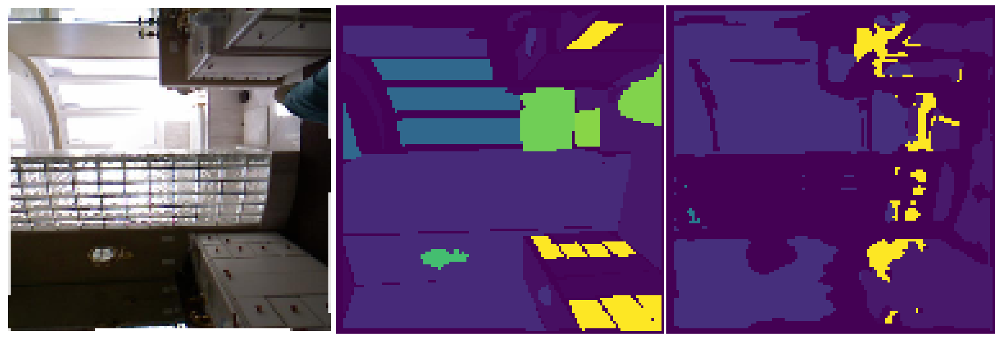

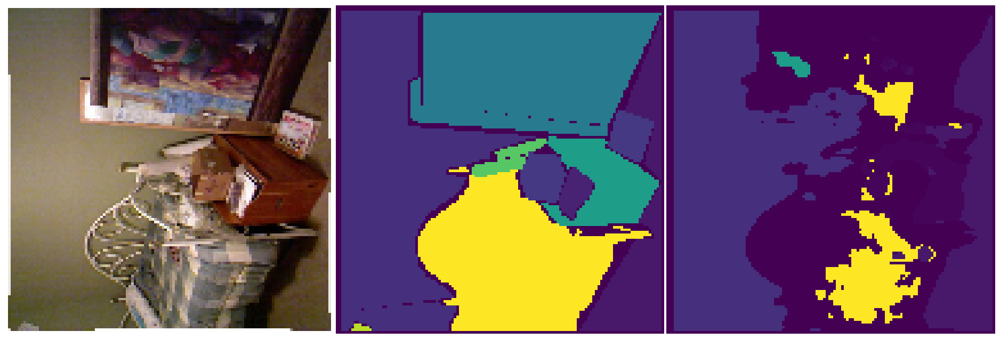

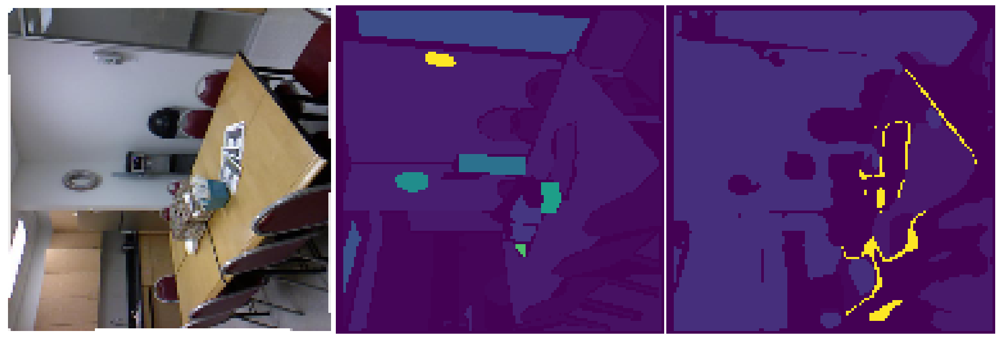

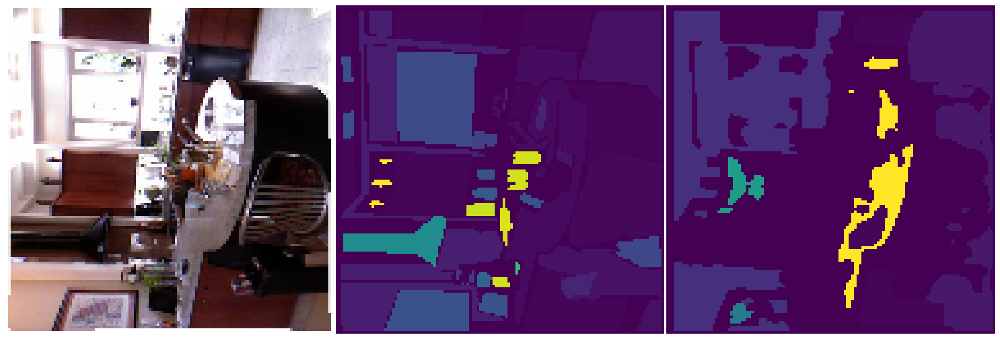

In [ ]:
visualize(model, next(iter(test_loader)), device=device)

### Резюме
1. Рассмотрели датасет NYUv2, обернули в Dataset и DataLoader.
2. Построили простую сеть, обучили — получили бейзлайн качества.
3. Взяли U-Net, обучили и улучшили метрику качества.

## Генерация лиц на примере DCGAN

_Вдохновлено этой [статьей](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)._

GAN — это архитектура, в которой две сети соревнуются друг с другом.
Одна сеть генерирует картинки, другая отличает настоящие картинки от сгенерированных.

Задача первой сети — выдать сгенерированное изображение за настоящее.
Задача второй сети — правильно отличить подделку от настоящей картинки.

Сформулируем задачу согласно пайплайну.

1. **Постановка задачи**. Хотим генерировать правдоподобные картинки лиц. Метрикой качества будет "на глаз".
2. **Подготовка данных**. Будем использовать датасет Celeba. Загрузите файл `img_align_celeba.zip` по [ссылке](https://drive.google.com/drive/folders/0B7EVK8r0v71pTUZsaXdaSnZBZzg?resourcekey=0-rJlzl934LzC-Xp28GeIBzQ), распакуйте его (получится папка `img_align_celeba/`), затем положите в папку `data`. Получится `data/img_align_celeba/000001.jpg`.
3. **Выбор модели, функции потерь и оптимизатора**. Тут поинтереснее.

Модель возьмем следующую: несколько `Conv2dTranspose + BatchNorm + ReLU`, которые преобразуют вектор (100, ) в картинку (3, 64, 64).
Такую модель предложили в статье [DCGAN](https://arxiv.org/abs/1511.06434).

Насчет лосса: возьмем сумму ошибок генератора и дискриминатора.
Пусть $D(x)$ — выход дискриминатора, $G(z)$ — картинка, которую выдаст генератор, получивший на вход некий $z \sim p_z (z)$.
Тогда лосс будет:
$$
\min_G \max_D V(D, G) = \min_G \max_D \left[ \mathbb{E}_{x \sim p_{data} (x)} \ln D(x) + \mathbb{E}_{z \sim p_z (z)} \ln (1 - D(G(z))) \right]
$$

In [ ]:
dataroot = "data/"
batch_size = 256
image_size = 64
nc = 3
# Размер латентного вектора - из него генератор будет создавать изображение
nz = 100
# Размер feature map в генераторе
ngf = 64
# Размер feature map в дискриминаторе
ndf = 64
num_epochs = 10
lr = 0.0002
beta1 = 0.5

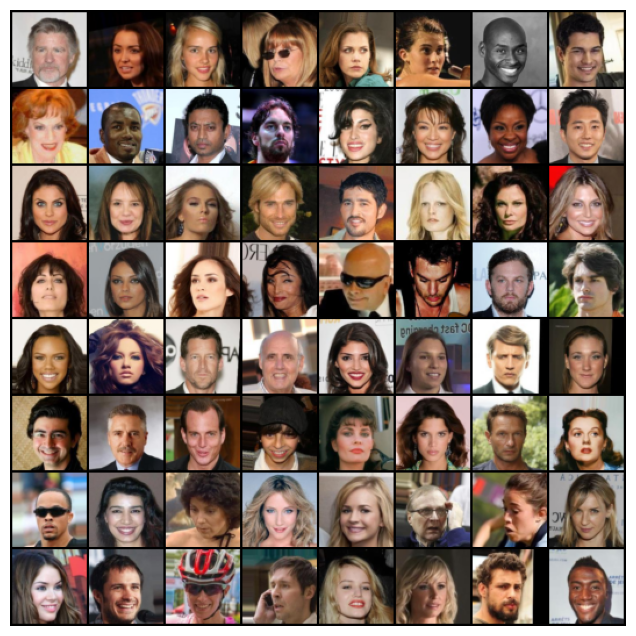

In [ ]:
import torchvision.utils as vutils
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms

dataset = ImageFolder(
    root=dataroot,
    transform=transforms.Compose(
        [
            transforms.Resize(image_size),
            transforms.RandomHorizontalFlip(p=0.5),
            transforms.CenterCrop(image_size),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
        ]
    ),
)
dataloader = DataLoader(
    dataset, batch_size=batch_size, shuffle=True, generator=generator, num_workers=6
)

real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.imshow(
    np.transpose(
        vutils.make_grid(
            real_batch[0].to(device)[:64], padding=2, normalize=True
        ).cpu(),
        (1, 2, 0),
    )
)
plt.show()

In [ ]:
# Инициализация весов
# Это советуют делать в оригинальной статье https://arxiv.org/abs/1511.06434
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm") != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # (ngf) x 32 x 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh(),
            # (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

netG = Generator().to(device)
netG.apply(weights_init)
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid(),
        )

    def forward(self, input):
        return self.main(input)


netD = Discriminator().to(device)
netD.apply(weights_init)
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [ ]:
criterion = nn.BCELoss()

# Рисовать картинки будем из одного и того же шума, чтобы суметь сравнить разные итерации
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Метки для настоящего и фальшивого изображения
real_label, fake_label = 1., 0.

optimizerD = Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
img_list = []
G_losses = []
D_losses = []
iters = 0

for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        # Максимизируем по дискриминатору log(D(x)) + log(1 - D(G(z)))
        # Шаг по реальной картинке
        netD.zero_grad()
        real_batch = data[0].to(device)
        b_size = real_batch.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_batch).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        # Шаг по фальшивой картинке
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        # Максимизируем по генератору log(D(G(z)))
        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        if i % 50 == 0:
            print(
                "[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f"
                % (
                    epoch,
                    num_epochs,
                    i,
                    len(dataloader),
                    errD.item(),
                    errG.item(),
                    D_x,
                    D_G_z1,
                    D_G_z2,
                )
            )
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        if (iters % 500 == 0) or (
            (epoch == num_epochs - 1) and (i == len(dataloader) - 1)
        ):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        iters += 1

[0/10][0/792]	Loss_D: 1.9126	Loss_G: 3.6357	D(x): 0.3987	D(G(z)): 0.4812 / 0.0409
[0/10][50/792]	Loss_D: 0.1778	Loss_G: 10.0678	D(x): 0.9151	D(G(z)): 0.0002 / 0.0002
[0/10][100/792]	Loss_D: 0.8539	Loss_G: 11.3741	D(x): 0.9402	D(G(z)): 0.5004 / 0.0001
[0/10][150/792]	Loss_D: 0.5623	Loss_G: 3.3575	D(x): 0.7317	D(G(z)): 0.1268 / 0.0506
[0/10][200/792]	Loss_D: 0.5478	Loss_G: 6.6282	D(x): 0.8943	D(G(z)): 0.2519 / 0.0028
[0/10][250/792]	Loss_D: 0.4205	Loss_G: 3.5678	D(x): 0.8571	D(G(z)): 0.1856 / 0.0474
[0/10][300/792]	Loss_D: 1.1824	Loss_G: 5.5233	D(x): 0.9665	D(G(z)): 0.6118 / 0.0123
[0/10][350/792]	Loss_D: 0.4967	Loss_G: 3.6290	D(x): 0.9077	D(G(z)): 0.2980 / 0.0408
[0/10][400/792]	Loss_D: 1.2341	Loss_G: 8.5460	D(x): 0.9298	D(G(z)): 0.5815 / 0.0006
[0/10][450/792]	Loss_D: 0.6317	Loss_G: 3.0793	D(x): 0.6638	D(G(z)): 0.0608 / 0.0684
[0/10][500/792]	Loss_D: 0.4789	Loss_G: 4.5324	D(x): 0.8492	D(G(z)): 0.2088 / 0.0205
[0/10][550/792]	Loss_D: 0.5627	Loss_G: 4.2501	D(x): 0.7408	D(G(z)): 0.1235 / 

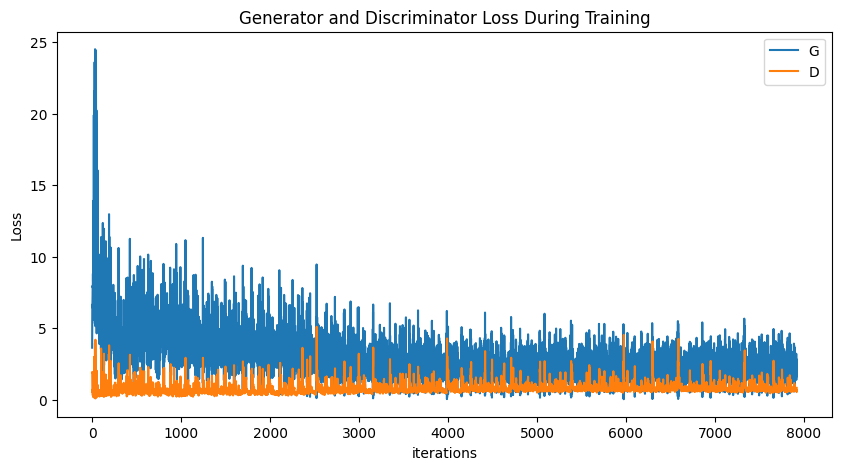

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

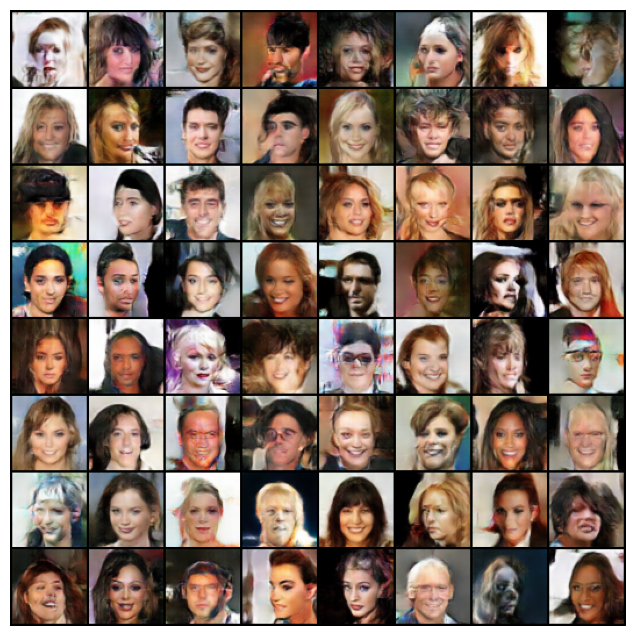

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

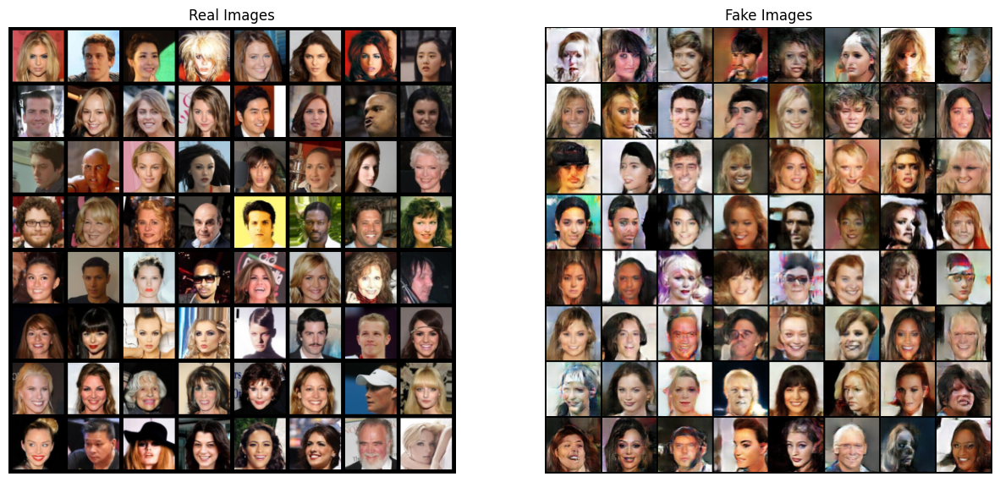

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

### Вывод
Простая архитектура DCGAN способна решать задачу генерации лиц, хотя качество не самое лучшее.

На DCGAN мир не остановился — вышло много улучшений.
Одна из недавних работ — [StyleGanV2](https://github.com/NVlabs/stylegan2-ada-pytorch).

## Резюме
1. Разобрали структуру U-Net.
2. Посмотрели, как решать задачу семантической сегментации с помощью U-Net.
3. Разобрали процесс обучения GAN.
3. Обучили DCGAN для генерации лиц, получили неплохое качество.